In [1]:
import pandas as pd
import numpy as np

import os
import glob
import re

from matplotlib import pyplot as plt
import seaborn as sns
from matplotlib import animation
from IPython.display import HTML

In [2]:
##data
input_fps = ['./example_data/0p8M.csv',
             './example_data/1M.csv']
parameter_column = 'Concentration'
time_column = None

In [3]:
print('Available models:')
for fn in glob.glob('checkpoints/*degradation4var*'):
    if not 'scaler' in fn:
        fn = fn.split('/')[-1]
        windows = re.findall(r'_\d+_\d+_',fn)[0]
        input_window=windows.split('_')[1]
        forecast_window = windows.split('_')[2]
        print(f'\tMax Input Window={input_window}, Prediction Window={forecast_window}')

Available models:
	Max Input Window=1000, Prediction Window=1000
	Max Input Window=1000, Prediction Window=1000


In [4]:
##model
max_input_window=1000
prediction_window=1000

In [5]:
for path in [f'./dataset/',f'./dataset/ROVI/',f'./dataset/ROVI/pred/']:
    if not os.path.exists(path):
        os.mkdir(path)

In [6]:
#reformat data files for input to iTransformer model
fns = []
for fp in input_fps:
    df = pd.read_csv(fp)

    fn = fp.split('/')[-1]

    norm_value = df[parameter_column].values[0]
    df['OT'] = df[parameter_column]/norm_value

    if time_column is None:
        df['timestamp'] = pd.date_range(start='2024-12-18 13:09:16.959331',freq='24H',periods=len(df))
    else:
        df['timestamp'] = pd.to_datetime(df[time_column])

    out_fp = f'./dataset/ROVI/pred/{fn}'
    df.to_csv(out_fp,index=False)
    fns.append(out_fp)

In [7]:
#!mkdir results
!sh ./scripts/long_term_forecast/ROVI_script/Transformer_ROVI_streaming_predict.sh $max_input_window $prediction_window

False
Args in experiment:
Basic Config
  Task Name:          ROVI_forecast       Is Training:        0                   
  Model ID:           ROVI_forecast_degradation4varfull_1000_1000_iTransformer_1DVar_ftM_sl1000_ll0_pl1000_dm32_nh4_el3_dl3_df128_expand2_dc4_fc1_ebtimeF_dtTrue_lr0.001_do0.0_patience20_Exp_0Model:              iTransformer        

Data Loader
  Data:               1DVar               Root Path:          ./dataset/ROVI/     
  Data Path:          ETTh1.csv           Features:           M                   
  Target:             OT                  Freq:               h                   
  Checkpoints:        ./checkpoints/      

Model Parameters
  Top k:              5                   Num Kernels:        6                   
  Enc In:             7                   Dec In:             7                   
  C Out:              7                   d model:            32                  
  n heads:            4                   e layers:           3           

In [8]:
def load_data(path):
    
    true = np.load(f'{path}/real_true.npy')
    preds = np.load(f'{path}/real_prediction.npy')
    x = np.load(f'{path}/real_x.npy')
    ids = np.load(f'{path}/real_ids.npy')
    
    return true, preds, x, ids

colors= sns.color_palette()

def find_zero_index(arr):
    # Iterate over the array to find the earliest possible index
    for i in range(len(arr)):
        if arr[i] < 1e-7 and np.all(arr[i:] < 1e-7):
            return i
    return -1

def get_curves(true,preds,x):
    if (x != 1.0).sum() > 0:
        start_idx = np.where(x != 1.0)[0][0] - 1
    else:
        start_idx = len(x)
        
    if start_idx > len(x) - 50:
        return

    input_cycles = range(len(x) - start_idx)
    x = x[start_idx:]
    
    pred_cycles = range(len(x),len(x)+len(preds))

    
    zero_idx = find_zero_index(true)
    idx = np.ones(len(true)).astype(bool)
    if zero_idx != -1:
        idx[zero_idx:]=False
    
    true = true[idx]
    true_cycles = range(len(x),len(x)+len(true))
    
    return(input_cycles, x, pred_cycles, preds, true_cycles, true)

def plot_curves(true, preds, x, labels=True, alpha=0.5):
    
    res = get_curves(true, preds, x)
    
    if not res is None:
        input_cycles, x, pred_cycles, preds, true_cycles, true = res
    else:
        return
    
    if len(true) == 0:
        return
    
    sns.set_context("talk")
    plt.plot(input_cycles,x,color=colors[1])
    if labels:
        plt.plot(true_cycles, true,color=colors[1],label='True',zorder=9)
    else:
        plt.plot(true_cycles, true,color=colors[1])
    if labels:
        plt.plot(pred_cycles, preds,color=colors[2],label='Predicted',alpha=alpha)
    else:
        plt.plot(pred_cycles, preds,color=colors[2],alpha=alpha)

    return(1)

def animate_curves(true,preds,x,ids, start = 0, end = 500):
    
    fig, ax = plt.subplots()

    pred_line, = ax.plot([], [], label='Predicted')
    in_line, = ax.plot([], [])
    true_line, = ax.plot([], [], label='True')

    ax.legend()
    
    ax.set_xlim(0, 1000)
    ax.set_ylim(0.7, 1.0)
    
    # Update function for the animation
    def get_frame(frame):
        
        t = true[frame,:,0]
        p = preds[frame,:,0]
        x0 = x[frame,:,0]
        
        res = get_curves(t, p, x0)
        
        if not res is None:
            return(res)
        else:
            return
        
    frames = [get_frame(i) for i in range(start,end) if not get_frame(i) is None]
        
        
    def update(frame):
        pred_line.set_data(frame[2], frame[3])
        in_line.set_data(frame[0], frame[1])
        true_line.set_data(frame[4], frame[5])

        return pred_line,in_line,true_line
    
    ani = animation.FuncAnimation(fig, update, frames=frames, blit=True, repeat=True)
    
    return(ani)

In [9]:
true, preds, x, ids = load_data(f'results/ROVI_forecast_degradation4varfull_{max_input_window}_{prediction_window}_iTransformer_1DVar_ftM_sl{max_input_window}_ll0_pl{prediction_window}_dm32_nh4_el3_dl3_df128_expand2_dc4_fc1_ebtimeF_dtTrue_lr0.001_do0.0_patience20_Exp_0')

In [10]:
ids

array(['0p8M.csv_0', '0p8M.csv_1', '0p8M.csv_2', ..., '1M.csv_997',
       '1M.csv_998', '1M.csv_999'], dtype='<U12')

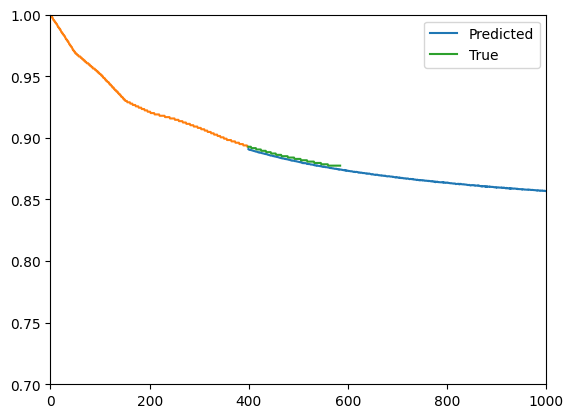

In [11]:
ani = animate_curves(true,preds,x,ids,start=1000, end=1400)

HTML(ani.to_jshtml())

Animation size has reached 20979298 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


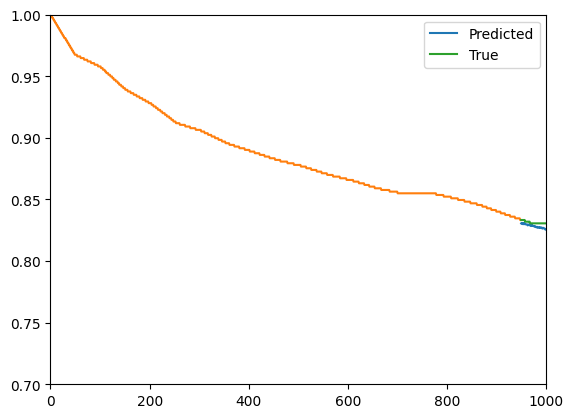

In [12]:
ani = animate_curves(true,preds,x,ids,start = 0, end = 950)

HTML(ani.to_jshtml())

Text(0.5, 1.0, '1M.csv_999')

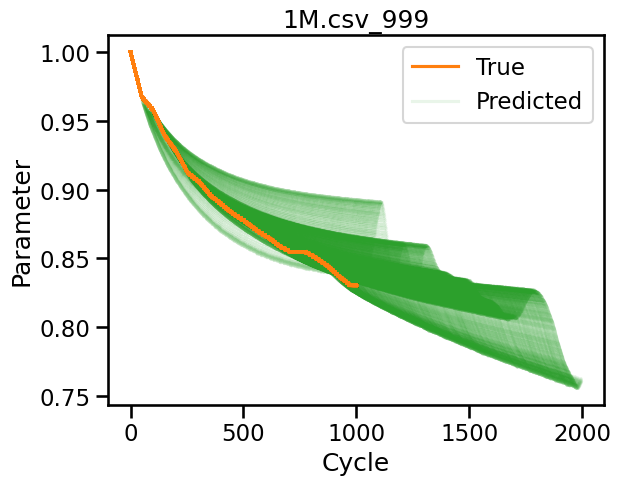

In [13]:
labels = True
for i in range(len(true)):
    if '0p8M' in ids[i]:
        res = plot_curves(true[i,:,0],preds[i,:,0],x[i,:,0],labels=labels,alpha=0.1)
        if not res is None:
            labels = False
    
plt.legend()
plt.xlabel('Cycle')
plt.ylabel('Parameter')
plt.title(ids[i])

Text(0.5, 1.0, '1M.csv_999')

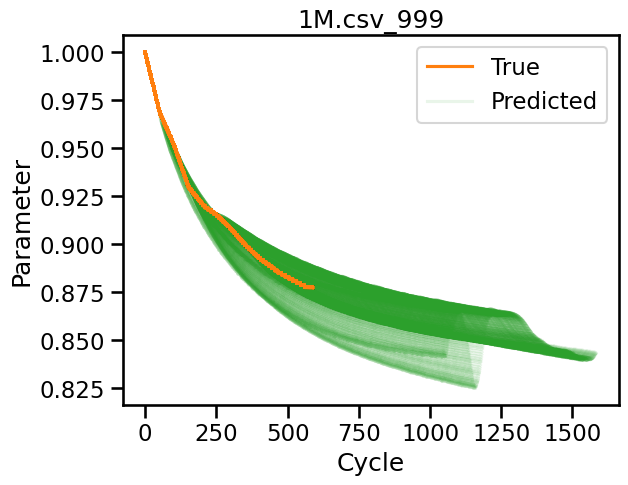

In [14]:
labels = True
for i in range(len(true)):
    if '1M' in ids[i]:
        res = plot_curves(true[i,:,0],preds[i,:,0],x[i,:,0],labels=labels,alpha=0.1)
        if not res is None:
            labels = False
    
plt.legend()
plt.xlabel('Cycle')
plt.ylabel('Parameter')
plt.title(ids[i])